This notebook demonstrates performance of mSSA model. It also saves/loads some data and figures. Model's parameters can be changed in the corresponding sections here.

In [14]:
# add path to ssa package
import sys
sys.path.append('../../..')

In [15]:
import numpy as np
import scipy.linalg as linalg
from matplotlib import pyplot as plt
import pandas as pd
import pathlib

import pickle

%matplotlib inline 

In [16]:
# mssa model
from src.ssa_methods.m_ssa import m_SSA

# plot with large fonts and other stuff
from src.plot.journal_style import EnableJournalStylePlotting

# data extraction methods
from src.data.accelerometer_1 import GetWalkData

## Data preprocessing

In [17]:
# names of observed signals
sig_names = ['$a_x$', '$a_y$', '$a_z$', '$w_x$', '$w_y$', '$w_z$']
# measure units
# acceleration is in g-units (g=9.8)
sig_units = ["m/$s^2$", "m/$s^2$", "m/$s^2$", "rad/s", "rad/s", "rad/s"]

num_signals = 6

In [18]:
# retrive signals and corresponding time grids
# this is walking motion
# first 3 components = accelerometer, last 3 - gyroscope
(train_data, time_grid_train), (test_data, time_grid_test) = GetWalkData()

print("Train len = ", train_data.shape[0])
print("Test len = ", test_data.shape[0])

Train len =  1375
Test len =  302


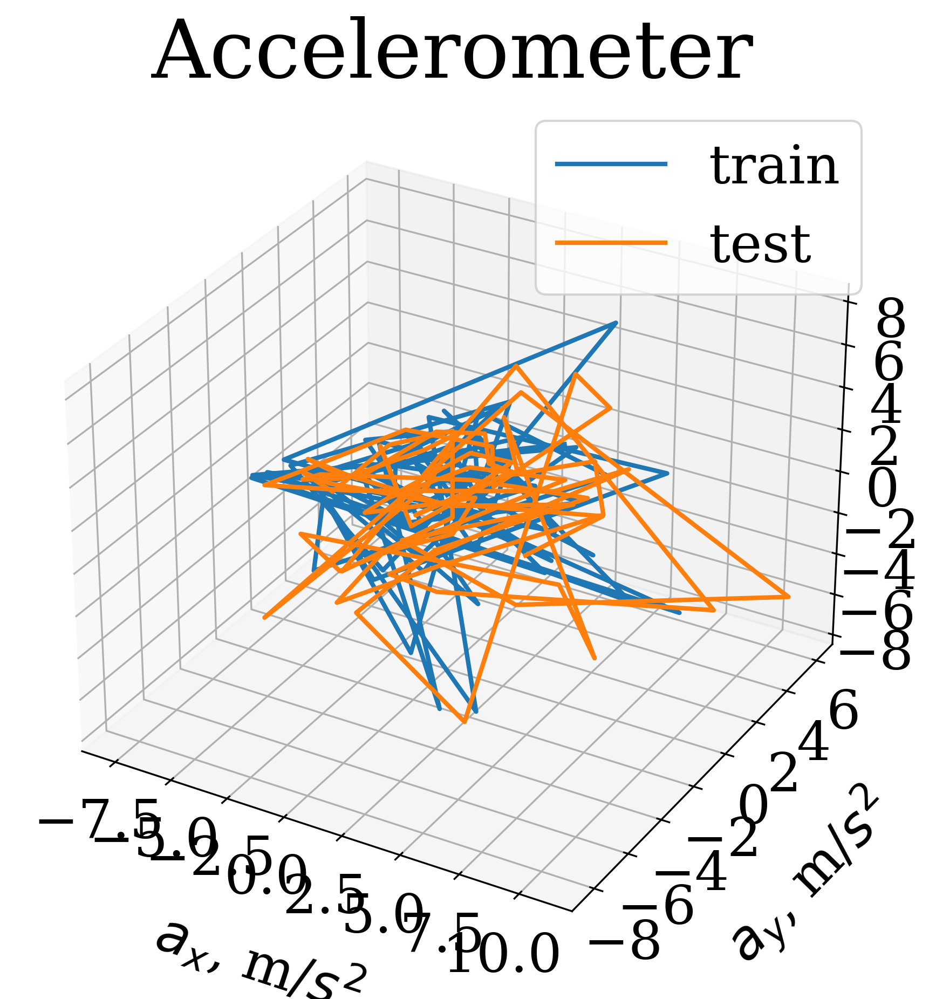

In [19]:
# draw accelerometer signals
with EnableJournalStylePlotting():
    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(projection='3d')
    
    train_points = train_data.T[:3, ::20]
    test_points = test_data.T[:3, ::4]
    
    ax.plot(*train_points, label="train")
    ax.plot(*test_points, label="test")
    
    ax.set_xlabel(f"{sig_names[0]}, {sig_units[0]}", labelpad=21)
    ax.set_ylabel(f"{sig_names[1]}, {sig_units[1]}", labelpad=21)
    ax.set_zlabel(f"{sig_names[2]}, {sig_units[2]}", labelpad=21)
    ax.set_title("Accelerometer")
    ax.legend()

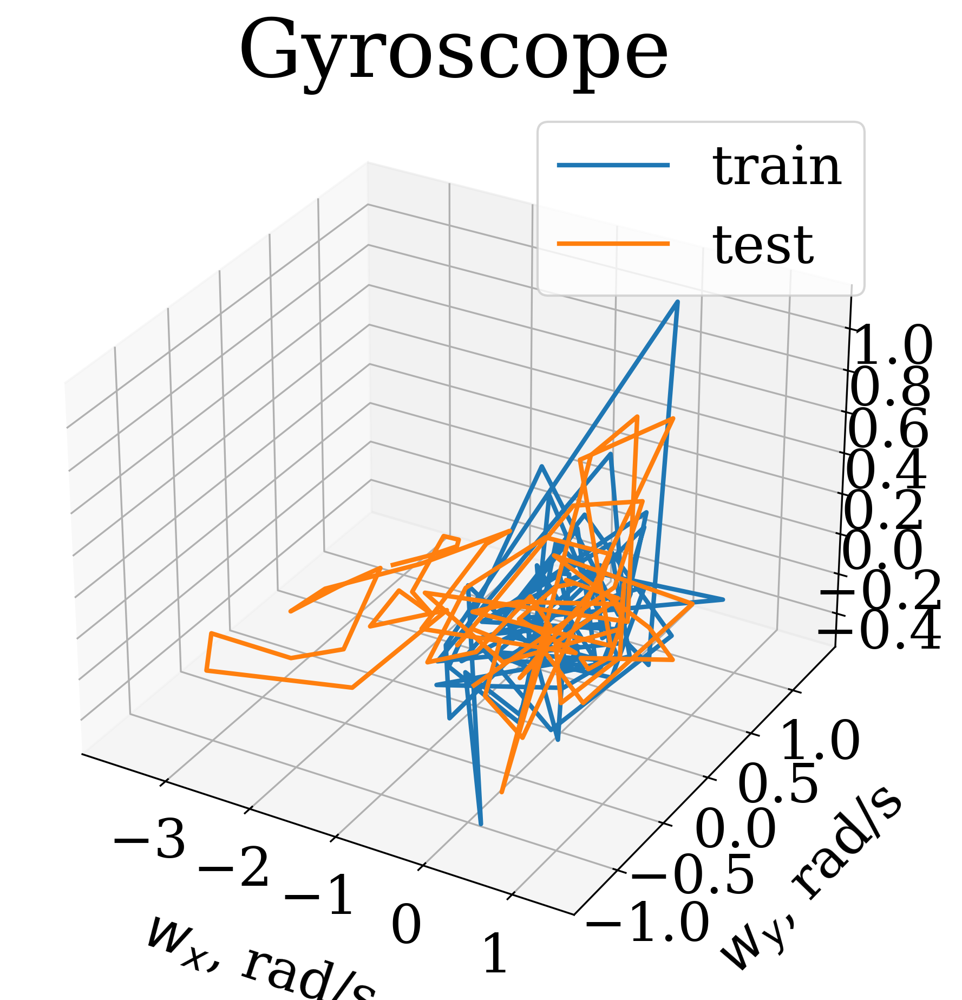

In [20]:
# draw gyro signals
with EnableJournalStylePlotting():
    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(projection='3d')

    train_points = train_data.T[3:, ::20]
    test_points = test_data.T[3:, ::4]

    ax.plot(*train_points, label="train")
    ax.plot(*test_points, label="test")

    ax.set_xlabel(f"{sig_names[3]}, {sig_units[3]}", labelpad=21)
    ax.set_ylabel(f"{sig_names[4]}, {sig_units[4]}", labelpad=21)
    ax.set_zlabel(f"{sig_names[5]}, {sig_units[5]}", labelpad=21)
    ax.set_title("Gyroscope")
    ax.legend()

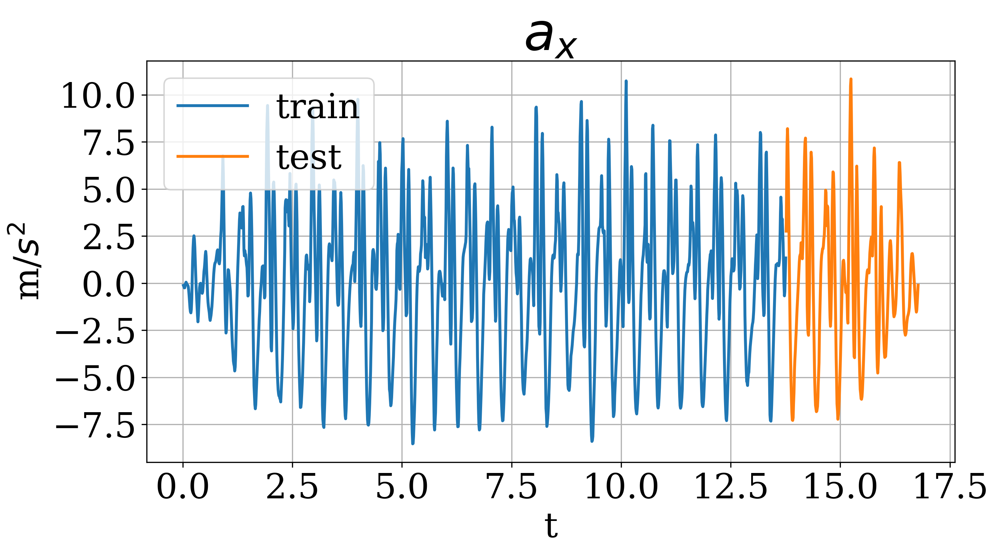

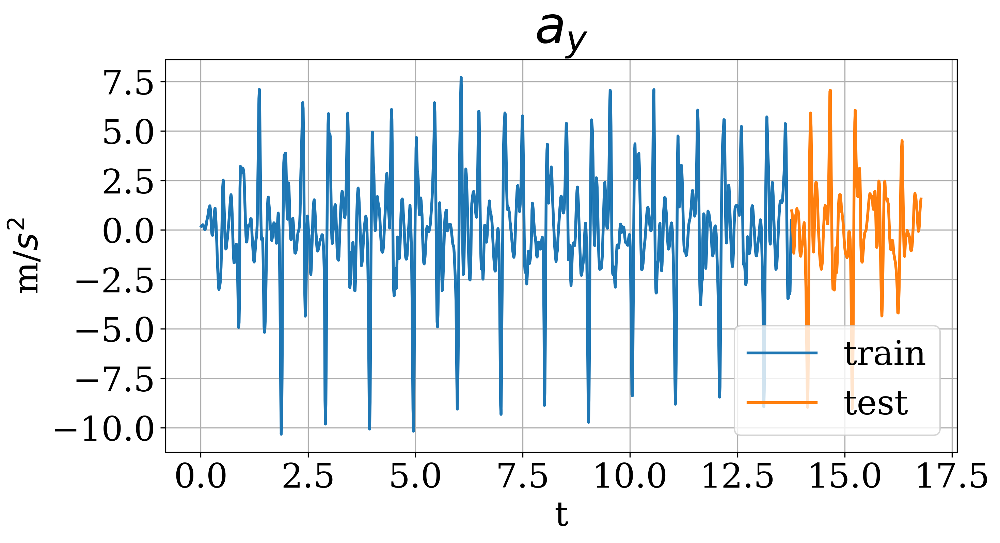

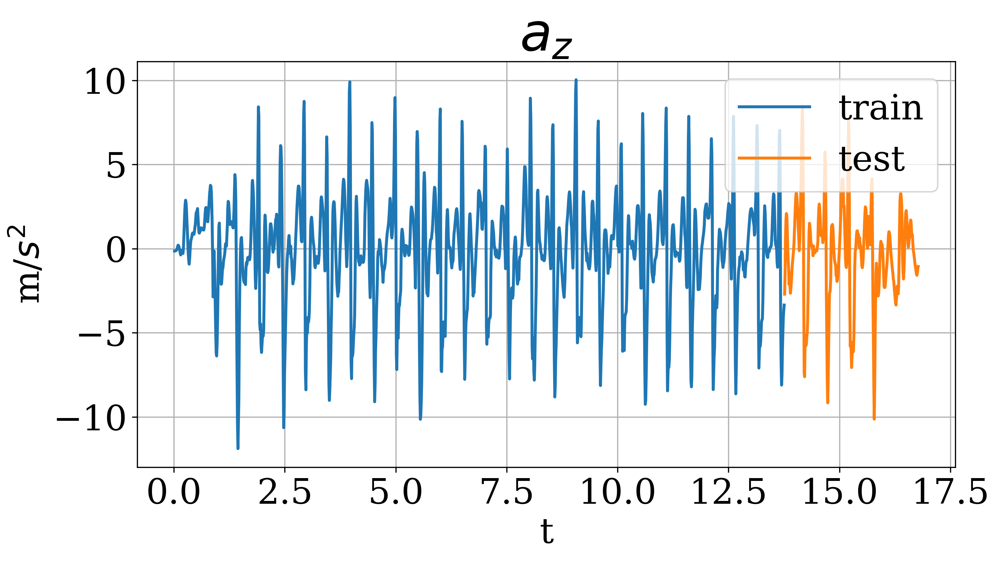

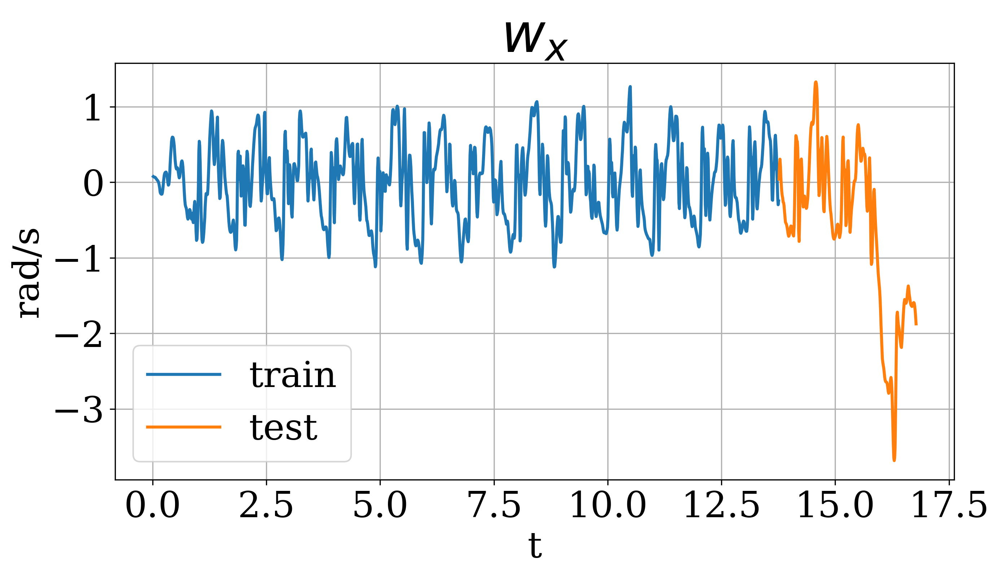

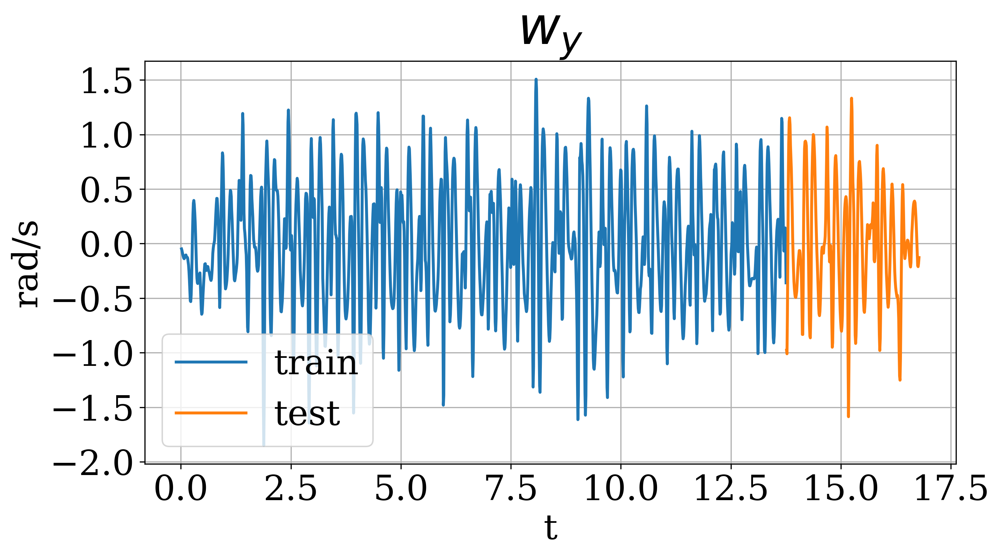

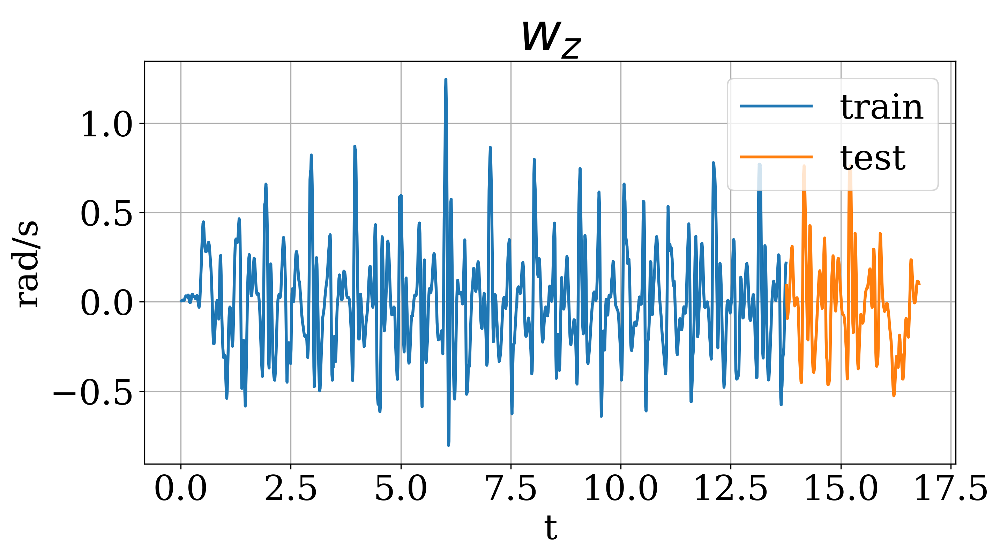

In [21]:
# draw signals
for i in range(num_signals):
    with EnableJournalStylePlotting():
        fig, ax = plt.subplots(figsize=(10, 5))

        ax.plot(time_grid_train, train_data.T[i], label='train')
        ax.plot(time_grid_test, test_data.T[i], label='test')

        ax.grid(True)
        ax.legend()
        ax.set_xlabel('t')
        ax.set_ylabel(sig_units[i])
        ax.set_title(sig_names[i])

## Global method parameters

In [22]:
# aka L parameter
ssa_window_size = 1000

## mSSA fitting

In [23]:
# make directory for models
pathlib.Path(f'./saved_model').mkdir(parents=True, exist_ok=True)

In [24]:
# load model if it already exists
if pathlib.Path(f'./saved_model/mssa_model.pkl').exists():
    with open(f'./saved_model/mssa_model.pkl', 'rb') as f:
        m_ssa_obj = pickle.load(f)
else:
    m_ssa_obj = m_SSA(ssa_window_size, train_data.T)

    # make svd for common matrix, extract factors and singular values
    m_ssa_obj.decompose_tt()

    # save model
    with open(f'./saved_model/mssa_model.pkl', 'wb') as f:
        pickle.dump(m_ssa_obj, f)

Text(0, 0.5, '$\\sigma$')

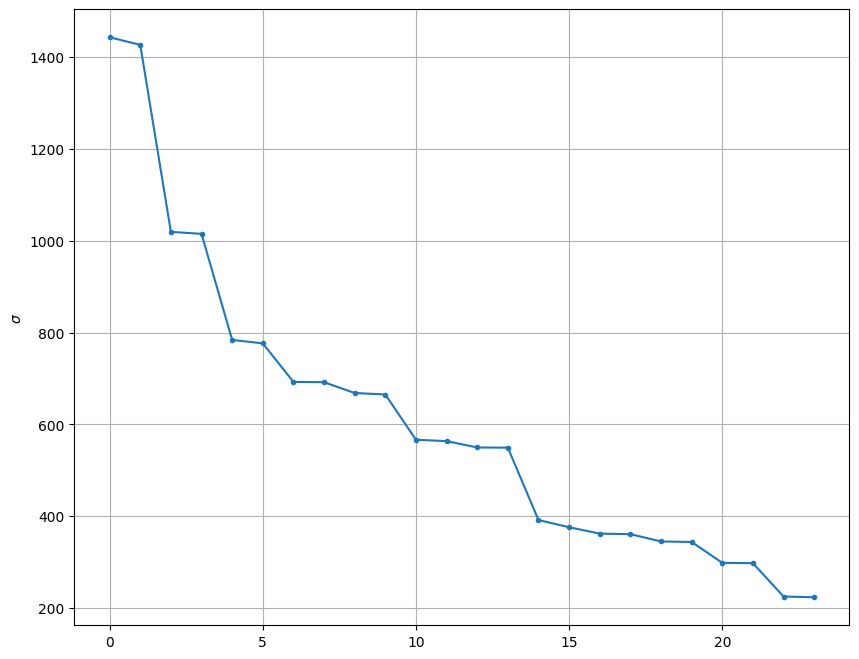

In [25]:
fig, ax = plt.subplots(figsize=(10, 8))

ax.plot(m_ssa_obj.weights[:24], marker='.')

ax.grid(True)
ax.set_ylabel("$\sigma$")

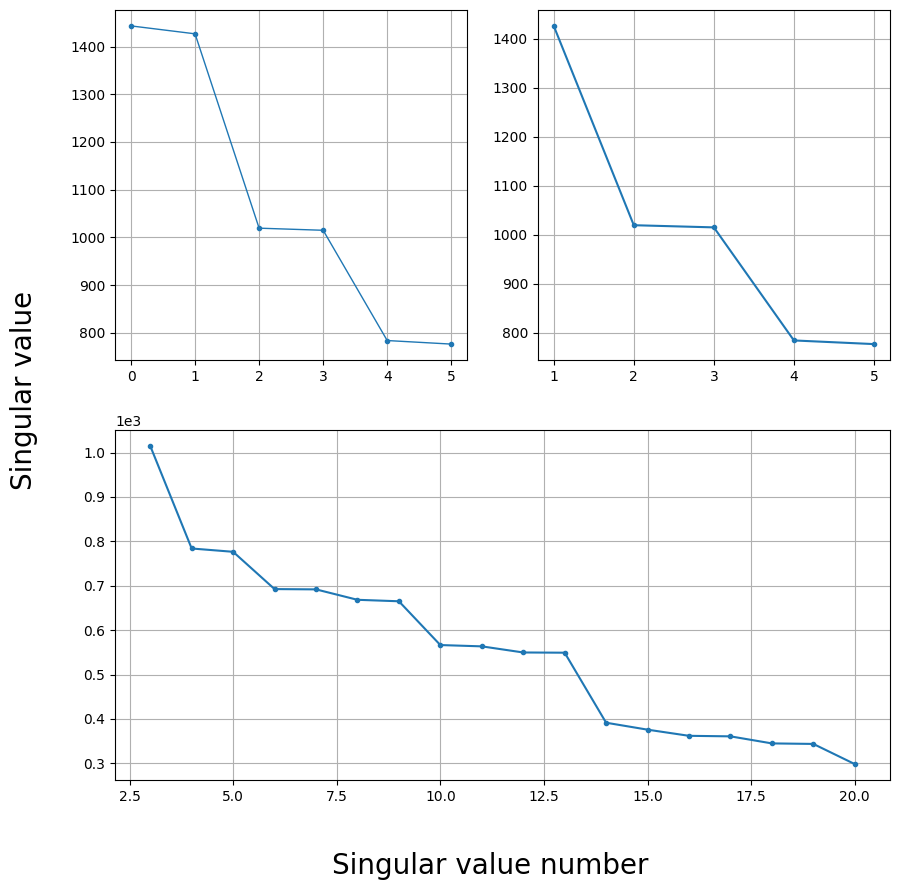

In [26]:
# have a look on singular values on diffrent scales
fig, axd = plt.subplot_mosaic([['left', 'right'], ['down', 'down']],figsize=(10, 10))

# put first 5 singular values on the left
axd['left'].plot(np.arange(0, 5 + 1), m_ssa_obj.weights[:5 + 1], marker='.', linewidth=1)
axd['left'].grid(True)

# put 2-5 singular values on the right
axd['right'].plot(np.arange(1, 5 + 1), m_ssa_obj.weights[1:5 + 1], marker='.')
axd['right'].grid(True)

# put 3-20 singular values on the right
axd['down'].plot(np.arange(3, 20 + 1, dtype=np.int16), m_ssa_obj.weights[3:20 + 1], marker='.')
axd['down'].grid(True)
axd['down'].ticklabel_format(style='sci', axis='y', scilimits=(0,0))

fig.supxlabel('Singular value number', fontsize=20)
fig.supylabel('Singular value', fontsize=20);

In [27]:
# how many value do first k singular values keep
print(f'Value of first {5} sing.vals. store {linalg.norm(m_ssa_obj.weights[:24], ord=2) / linalg.norm(m_ssa_obj.weights, ord=2)} information')

Value of first 5 sing.vals. store 0.9342077618693879 information


Let's keep first 24 components

In [28]:
m_ssa_obj.dispose_factors(np.arange(6, len(m_ssa_obj.weights)))

0.664245426161954

## Decomposition

In [29]:
# colours for our signals (https://colorhunt.co/palette/808836ffbf00ff9a00d10363)
color_list = ['#808836', '#FFBF00', '#FF9A00', "#D10363", "#6C0345", "#DC6B19"]

In [30]:
def FitAndDescribe(groups: list):
    """fit mssa object with grouping, print hankel residuals, plot signal's components

    Args:
        groups (list): 
    Returns: components figures
    """
    for i in range(train_data.shape[1]):
        m_ssa_obj.set_factors_grouping(groups[i], i)

    comp_sigs, hank_resid_abs, hank_resid_rel = m_ssa_obj.decompose_signals()

    # view relative hankerlization errors
    for i in range(train_data.shape[1]):
        print(f'Group for {sig_names[i]}: {groups[i]}')
        print(f'Rel hankel. errors for {sig_names[i]}\n{hank_resid_rel[i].tolist()}\nMean = {np.mean(hank_resid_rel[i])}\n')

    figs_container = []

    # plot results
    for i in range(train_data.shape[1]):
        with EnableJournalStylePlotting():
            fig, axs = plt.subplots(nrows=len(comp_sigs[i]), ncols=1, figsize=(15, 8))
            figs_container.append(fig)
    
            for j in range(len(comp_sigs[i])):
                axs[j].plot(time_grid_train, comp_sigs[i][j], label=f'Component {j + 1}', color=color_list[i])
    
                if j != len(comp_sigs[i]) - 1:
                    axs[j].tick_params(axis='x', labelsize=0)
    
                axs[j].grid(True)
                axs[j].legend()
    
            fig.supylabel(f'{sig_units[i]}', fontsize=20)
            fig.supxlabel('$t$', fontsize=20)
            fig.suptitle(f'{sig_names[i]}', fontsize=30)
    
    return figs_container

### Manual singular values grouping 1

Group for $a_x$: [[0, 1], [2, 3], [4, 5]]
Rel hankel. errors for $a_x$
[0.3593912293978321, 0.3735823225915144, 0.37878214576103975]
Mean = 0.37058523258346215

Group for $a_y$: [[0, 1], [2, 3], [4, 5]]
Rel hankel. errors for $a_y$
[0.4327231057879932, 0.39441855944197385, 0.49353811094037725]
Mean = 0.4402265920567814

Group for $a_z$: [[0, 1], [2, 3], [4, 5]]
Rel hankel. errors for $a_z$
[0.3639339480550939, 0.37494569620610185, 0.3752512844925814]
Mean = 0.3713769762512591

Group for $w_x$: [[0, 1], [2, 3], [4, 5]]
Rel hankel. errors for $w_x$
[0.43117254041169384, 0.39317238231383844, 0.6162429860006315]
Mean = 0.48019596957538796

Group for $w_y$: [[0, 1], [2, 3], [4, 5]]
Rel hankel. errors for $w_y$
[0.3721640779690875, 0.3725139766323687, 0.3751893548182075]
Mean = 0.3732891364732212

Group for $w_z$: [[0, 1], [2, 3], [4, 5]]
Rel hankel. errors for $w_z$
[0.4457158679062246, 0.5181557939371846, 0.6896519498654078]
Mean = 0.5511745372362723



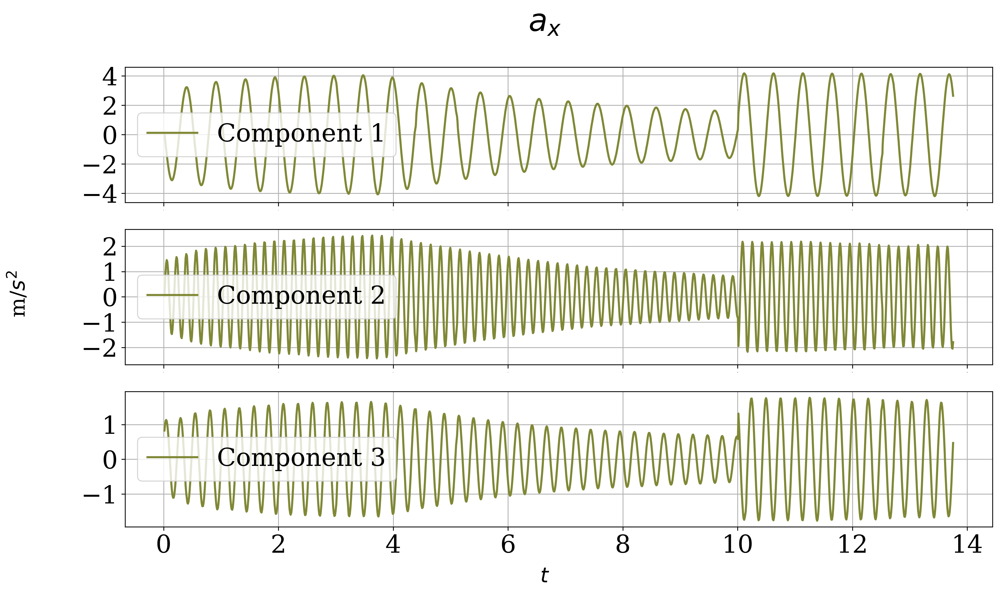

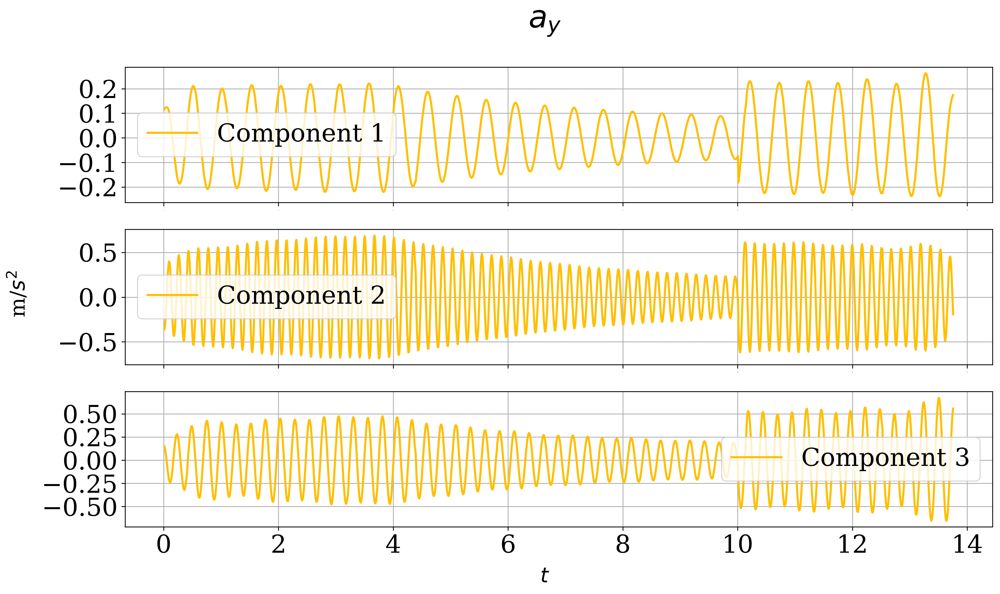

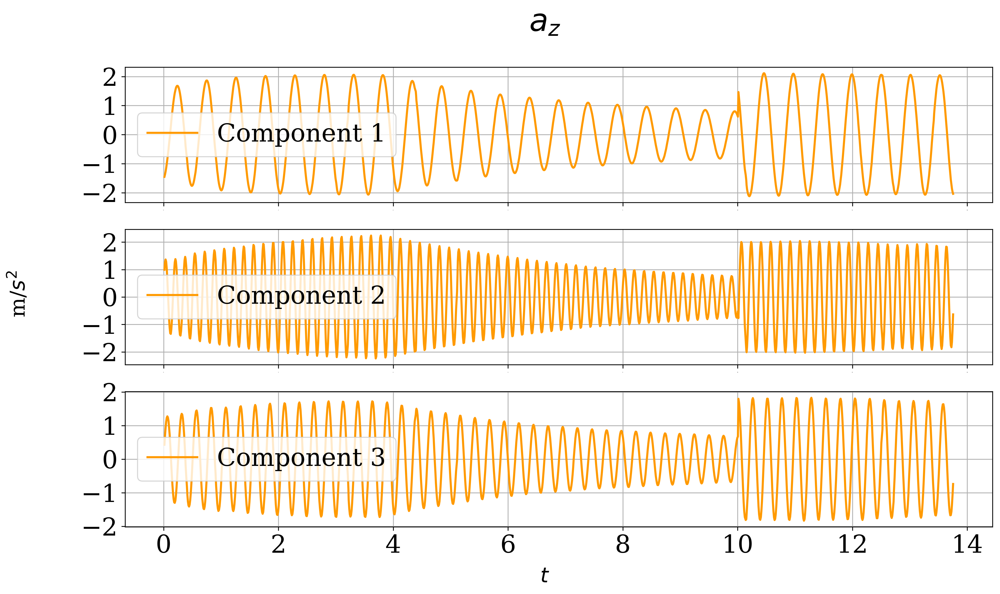

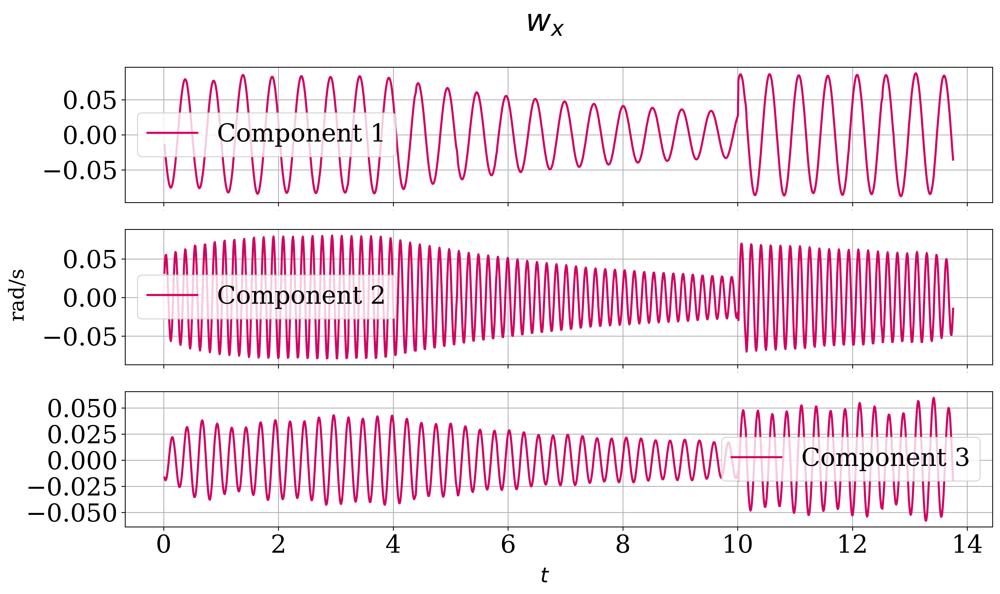

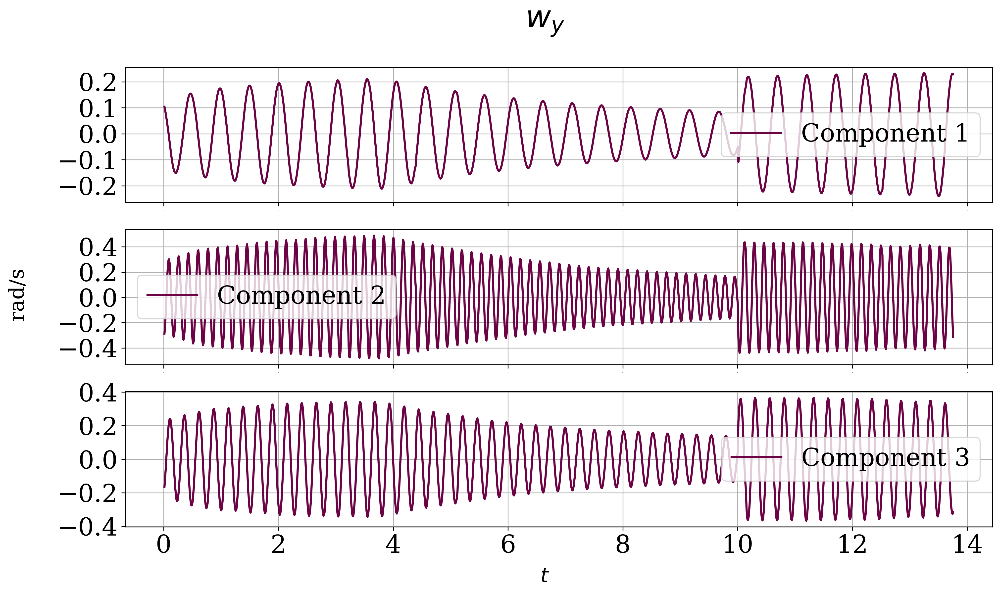

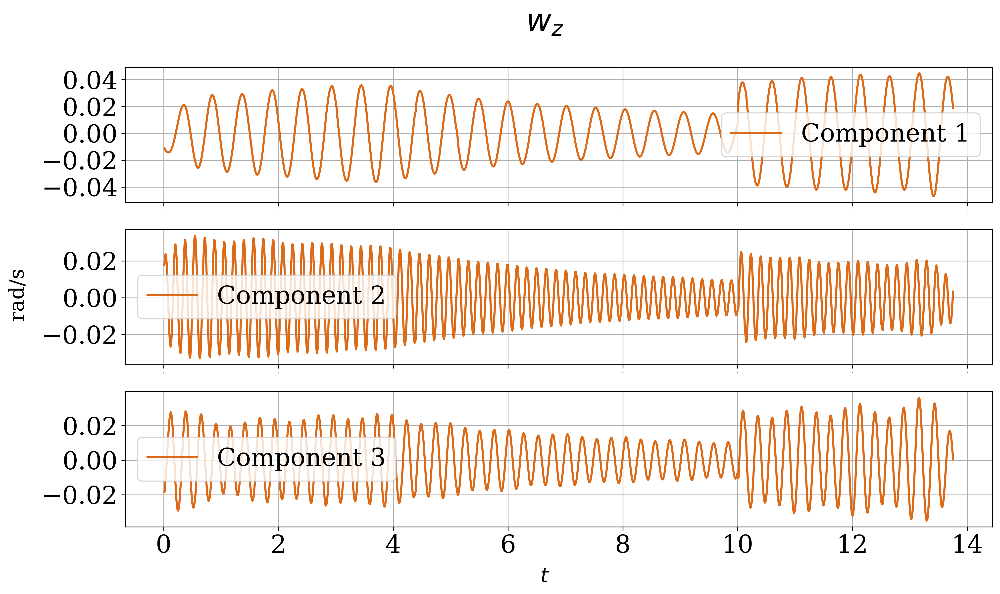

In [31]:
# every signal has the same grouping
my_grouping = [[[0, 1], [2, 3], [4, 5]] for _ in range(num_signals)]
my_grouping_id = 2

# save chosen grouping
#with open(f'./saved_grouping/manual/grouping_{my_grouping_id}.pkl', 'wb') as f:
#    pickle.dump(my_grouping, f)

component_figs = FitAndDescribe(my_grouping)

# make directory for figures for chosen grouping
pathlib.Path(f'./figs/decomposition/manual/grouping_{my_grouping_id}').mkdir(parents=True, exist_ok=True)

# save figures
for i in range(len(component_figs)):
    component_figs[i].savefig(
        f'./figs/decomposition/manual/grouping_{my_grouping_id}/{sig_names[i].replace(" ", "_")}.png',
        format='png'
    )

In [33]:
# save chosen grouping
pathlib.Path("./saved_grouping/manual/").mkdir(exist_ok=True, parents=True)

with open(f'./saved_grouping/manual/grouping_{my_grouping_id}.pkl', 'wb') as f:
    pickle.dump(my_grouping, f)

In [34]:
for i in range(train_data.shape[1]):
        m_ssa_obj.set_factors_grouping(my_grouping[i], i)

comp_sigs, hank_resid_abs, hank_resid_rel = m_ssa_obj.decompose_signals()

In [35]:
rhe_array = np.vstack(hank_resid_rel)
rhe_array

array([[0.35939123, 0.37358232, 0.37878215],
       [0.43272311, 0.39441856, 0.49353811],
       [0.36393395, 0.3749457 , 0.37525128],
       [0.43117254, 0.39317238, 0.61624299],
       [0.37216408, 0.37251398, 0.37518935],
       [0.44571587, 0.51815579, 0.68965195]])

In [36]:
rhe_array = np.vstack(hank_resid_rel)
rhe_array = np.mean(rhe_array, axis=1)

print("RHE accel", np.mean(rhe_array[:3]))
print("RHE gyro", np.mean(rhe_array[3:]))

RHE accel 0.3940629336305009
RHE gyro 0.4682198810949605


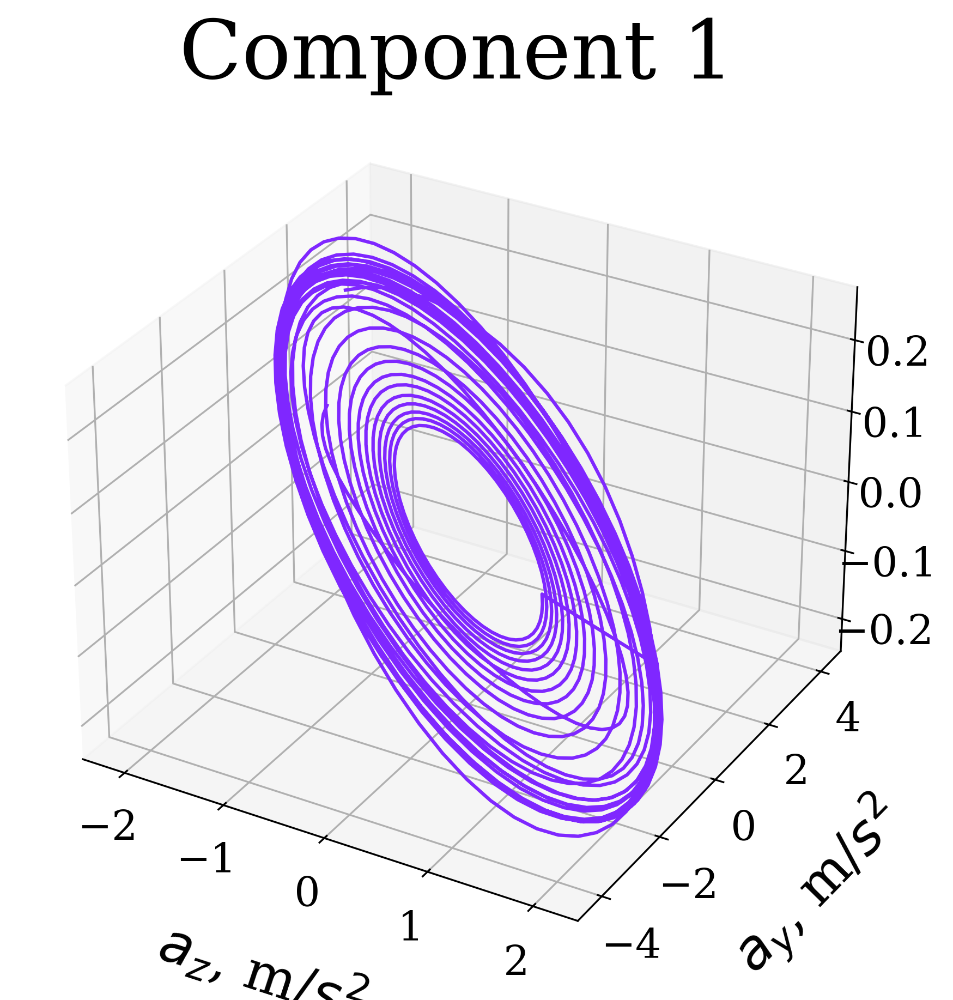

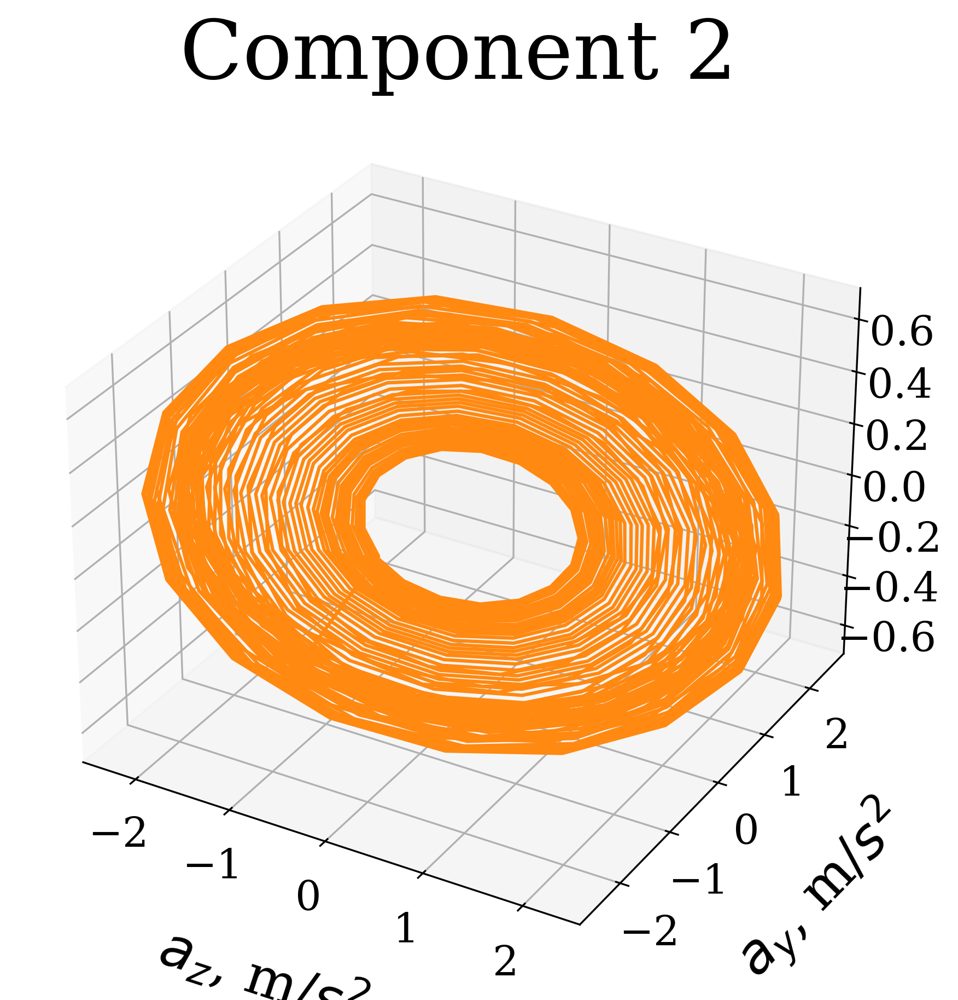

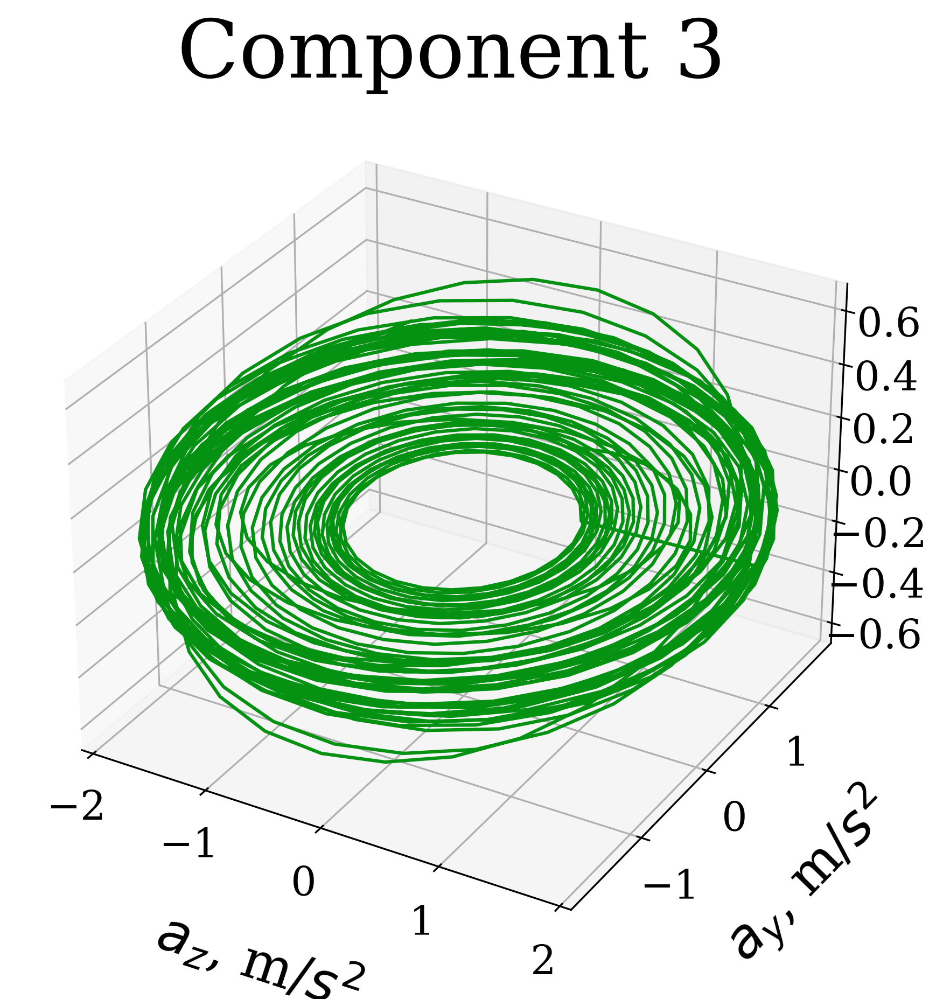

In [55]:
# plot 3d acceler results
component_colors = ["#7F27FF", "#FF8911", "#059212"]

with EnableJournalStylePlotting():
    num_components = len(my_grouping[0])
    for j in range(num_components):
        fig = plt.figure(figsize=(10, 7))
        ax = fig.add_subplot(projection='3d')

        component_points = np.array([comp_sigs[0][j], comp_sigs[1][j], comp_sigs[2][j]])


        if j == 0:
            ax.plot(*component_points, zdir="x", color=component_colors[j], linewidth=1.5)

            ax.set_xlabel(f"{sig_names[2]}, {sig_units[2]}", labelpad=21)
            ax.set_ylabel(f"{sig_names[1]}, {sig_units[1]}", labelpad=21)
            ax.set_zlabel(f"{sig_names[0]}, {sig_units[0]}", labelpad=21)
            ax.set_title(f"Component {j + 1}")
        if j == 1:
            ax.plot(*component_points, zdir="x", color=component_colors[j], linewidth=1.5)

            ax.set_xlabel(f"{sig_names[2]}, {sig_units[2]}", labelpad=21)
            ax.set_ylabel(f"{sig_names[1]}, {sig_units[1]}", labelpad=21)
            ax.set_zlabel(f"{sig_names[0]}, {sig_units[0]}", labelpad=21)
            ax.set_title(f"Component {j + 1}")
        if j == 2:
            ax.plot(*component_points, zdir="x", color=component_colors[j], linewidth=1.5)

            ax.set_xlabel(f"{sig_names[2]}, {sig_units[2]}", labelpad=21)
            ax.set_ylabel(f"{sig_names[1]}, {sig_units[1]}", labelpad=21)
            ax.set_zlabel(f"{sig_names[0]}, {sig_units[0]}", labelpad=21)
            ax.set_title(f"Component {j + 1}")
            

        for axis in ["x", "y", "z"]:
            #ax.ticklabel_format(axis=axis, style="scientific", scilimits=(0, 0))
            ax.tick_params(axis=axis, labelsize=18)

        # for index, label in enumerate(ax.xaxis.get_ticklabels()):
        #     if index % 2 == 0:
        #         label.set_visible(False)
        # for index, label in enumerate(ax.yaxis.get_ticklabels()):
        #     if index % 2 != 0:
        #         label.set_visible(False)
        # for index, label in enumerate(ax.zaxis.get_ticklabels()):
        #     if index % 2 == 0:
        #         label.set_visible(False)
        
        fig.savefig(f"./figs/decomposition/manual/grouping_{my_grouping_id}/acceler_{j + 1}.png", format='png')

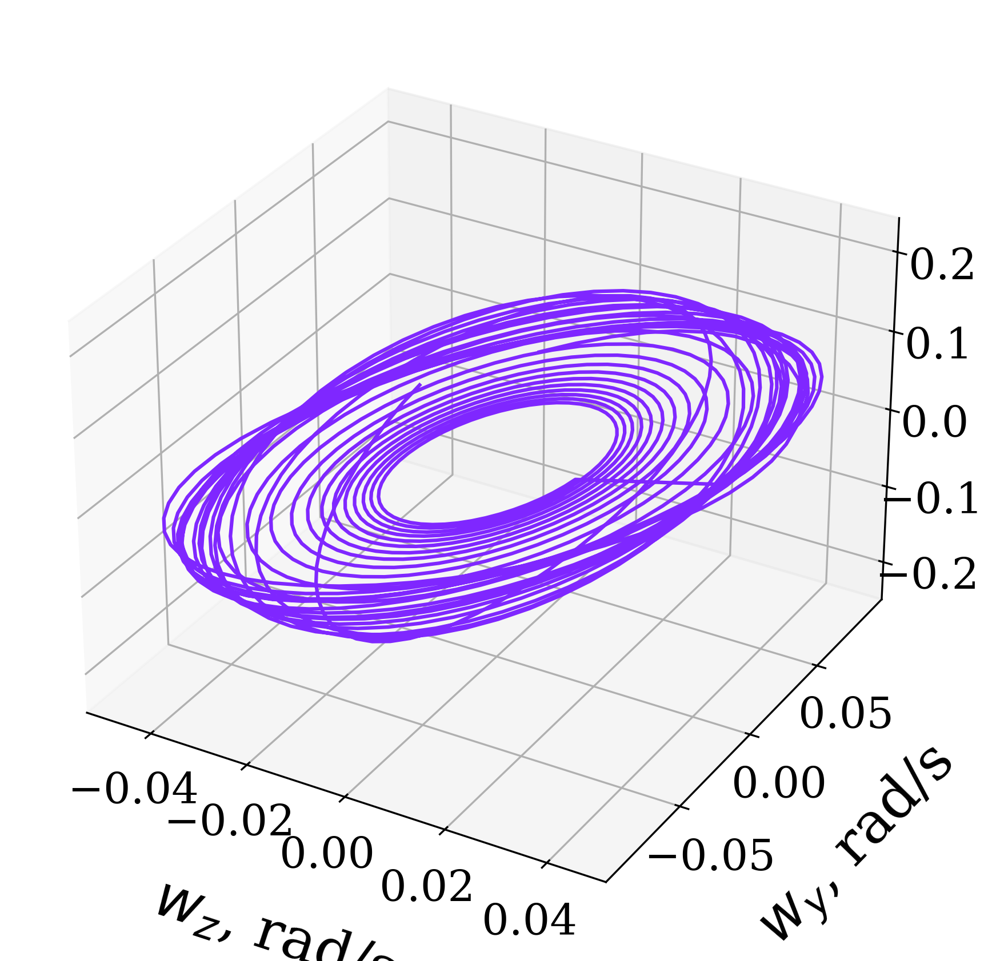

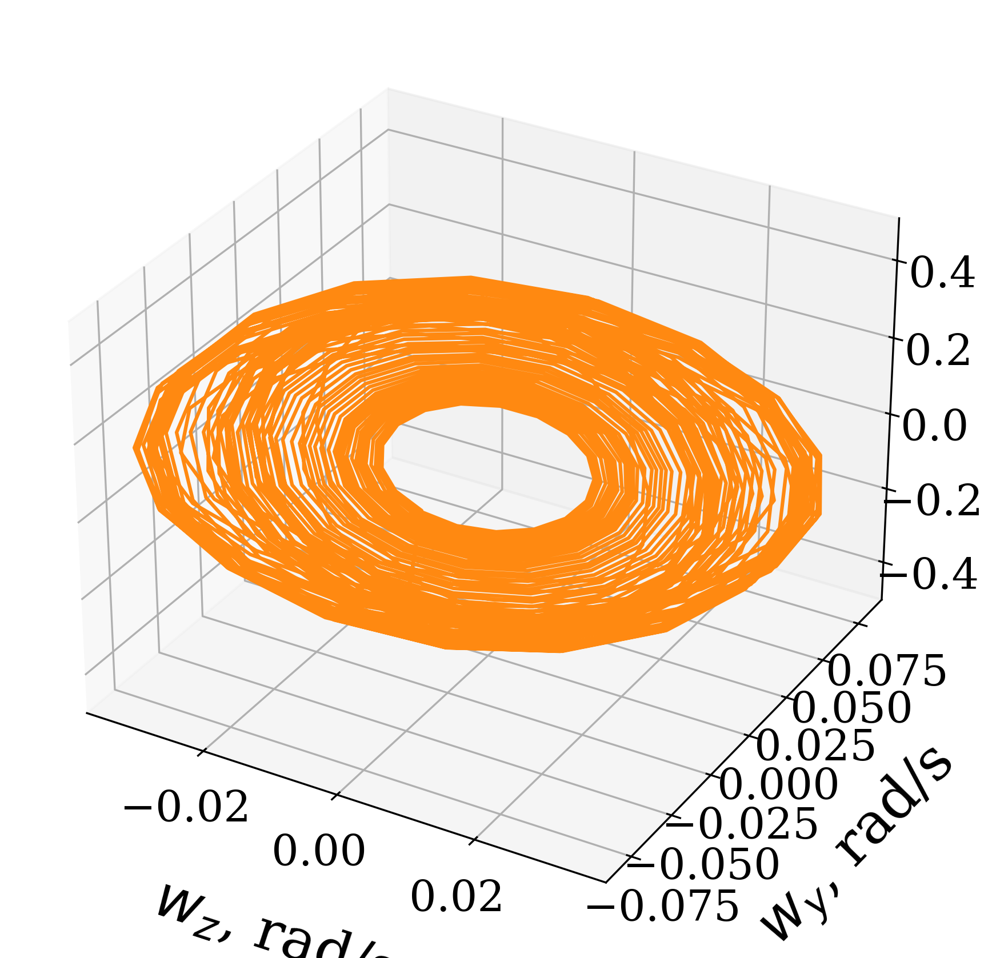

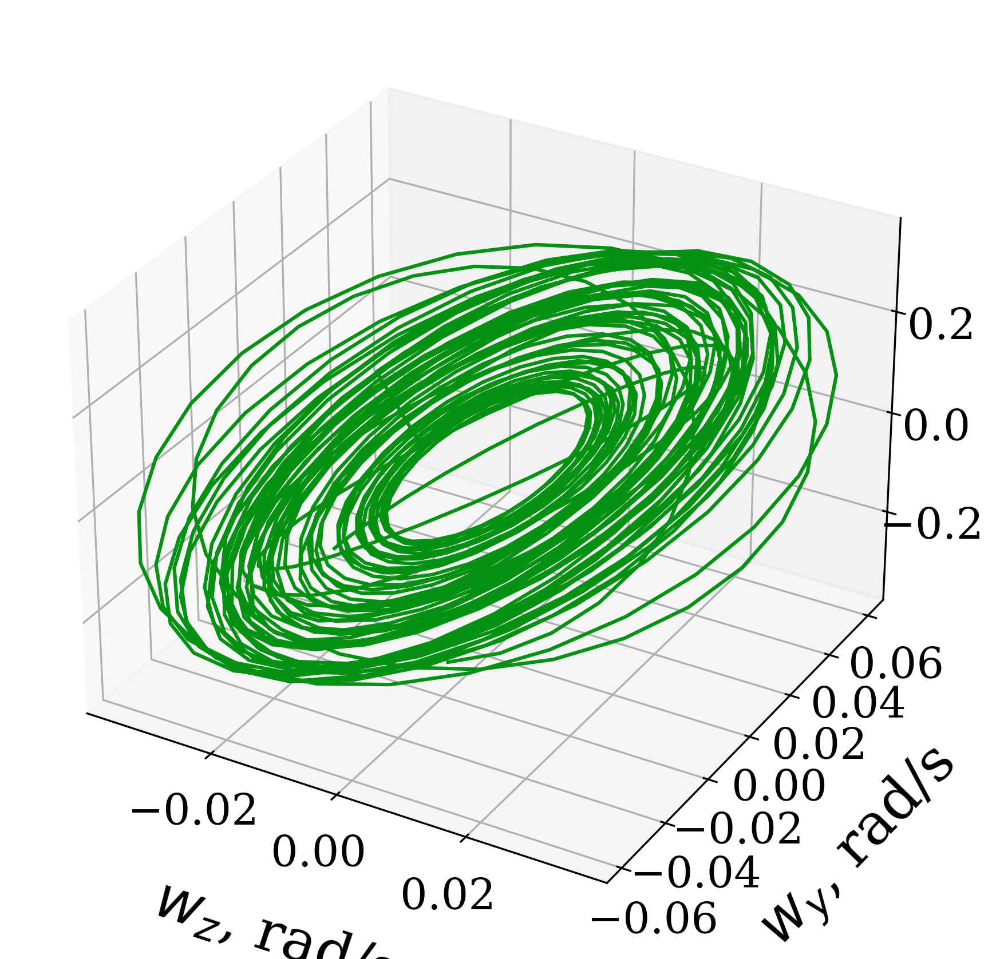

In [56]:
# plot 3d gyro results

with EnableJournalStylePlotting():
    num_components = len(comp_sigs[0])
    for j in range(num_components):
        fig = plt.figure(figsize=(10, 7))
        ax = fig.add_subplot(projection='3d')

        component_points = np.array([comp_sigs[3][j], comp_sigs[4][j], comp_sigs[5][j]])
        #component_points = component_points[:, :50]

        if j == 2:
            ax.plot(*component_points, zdir="x", color=component_colors[j], linewidth=1.5)

            ax.set_xlabel(f"{sig_names[5]}, {sig_units[5]}", labelpad=21)
            ax.set_ylabel(f"{sig_names[4]}, {sig_units[4]}", labelpad=21)
            ax.set_zlabel(f"{sig_names[3]}, {sig_units[3]}", labelpad=21)
        else:
            ax.plot(*component_points, zdir="x", color=component_colors[j], linewidth=1.5)
    
            ax.set_xlabel(f"{sig_names[5]}, {sig_units[5]}", labelpad=21)
            ax.set_ylabel(f"{sig_names[4]}, {sig_units[4]}", labelpad=21)
            ax.set_zlabel(f"{sig_names[3]}, {sig_units[3]}", labelpad=21)

        for axis in ["x", "y", "z"]:
            #ax.ticklabel_format(axis=axis, style="scientific", scilimits=(0, 0))
            ax.tick_params(axis=axis, labelsize=18)

        # for index, label in enumerate(ax.xaxis.get_ticklabels()):
        #     if index % 2 == 0:
        #         label.set_visible(False)
        # for index, label in enumerate(ax.yaxis.get_ticklabels()):
        #     if index % 2 != 0:
        #         label.set_visible(False)
        # for index, label in enumerate(ax.zaxis.get_ticklabels()):
        #     if index % 2 == 0:
        #         label.set_visible(False)
        
        fig.savefig(f"./figs/decomposition/manual/grouping_{my_grouping_id}/gyro_{j + 1}.png", format='png')

## Prediction

In [49]:
# make directory for figures
pathlib.Path(f'./figs/prediction').mkdir(parents=True, exist_ok=True)

In [50]:
m_ssa_obj.remove_last_predictions()

# get prediction for cuurent number of factors left
forecast_mssa = np.empty(test_data.shape)

for i in range(test_data.shape[0]):
    forecast_mssa[i] = np.array(m_ssa_obj.predict_next())

# get MSE for every signal
signals_mse_mssa = np.mean((forecast_mssa - test_data) ** 2, axis=0)
# get MAPE for every signal
signals_mape_mssa = np.mean(np.abs((forecast_mssa - test_data) / test_data), axis=0)

print(f'MSE: {signals_mse_mssa}; Mean by signals = {np.mean(signals_mse_mssa):e}')
print(f'MAPE: {signals_mape_mssa}; Mean by signals = {np.mean(signals_mape_mssa)}')

MSE: [9.64717477 5.52942017 5.76239898 1.56742874 0.27401874 0.06745174]; Mean by signals = 3.807982e+00
MAPE: [2.27357652 1.51666144 6.75715479 5.55027224 4.21575665 2.0619667 ]; Mean by signals = 3.729231389242124


In [51]:
print(f'Acc MSE: {np.mean(signals_mse_mssa[:3])}')
print(f'Acc MAPE: {np.mean(signals_mape_mssa[:3])}')

print(f'Gyro MSE: {np.mean(signals_mse_mssa[3:])}')
print(f'Gyro MAPE: {np.mean(signals_mape_mssa[3:])}')

Acc MSE: 6.979664639181617
Acc MAPE: 3.515797582091501
Gyro MSE: 0.6362997395987233
Gyro MAPE: 3.9426651963927477


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


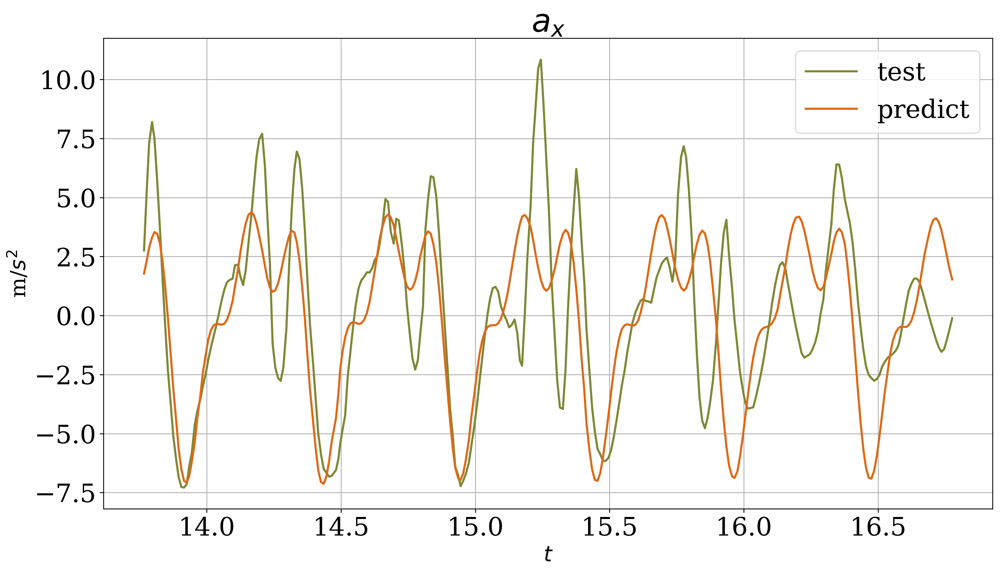

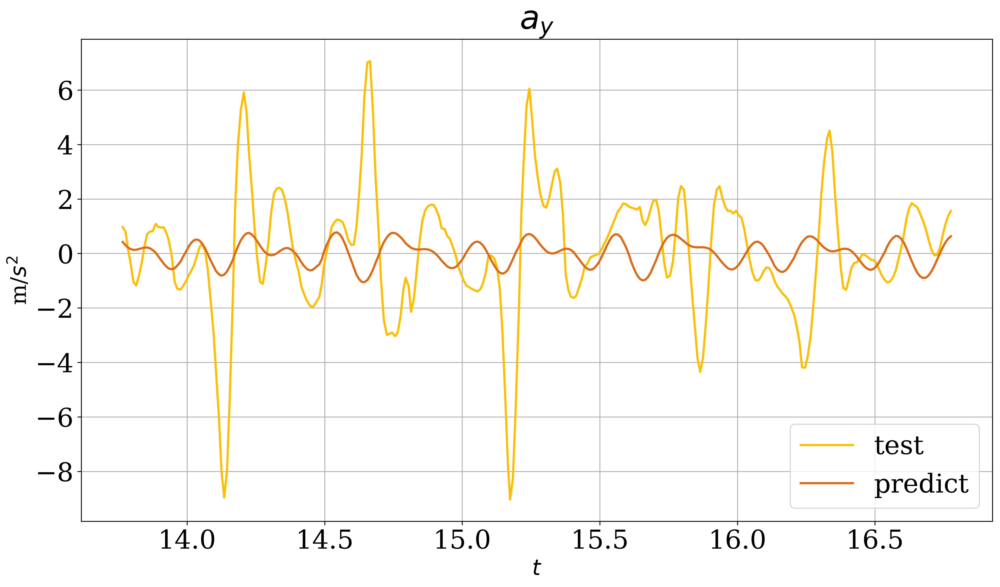

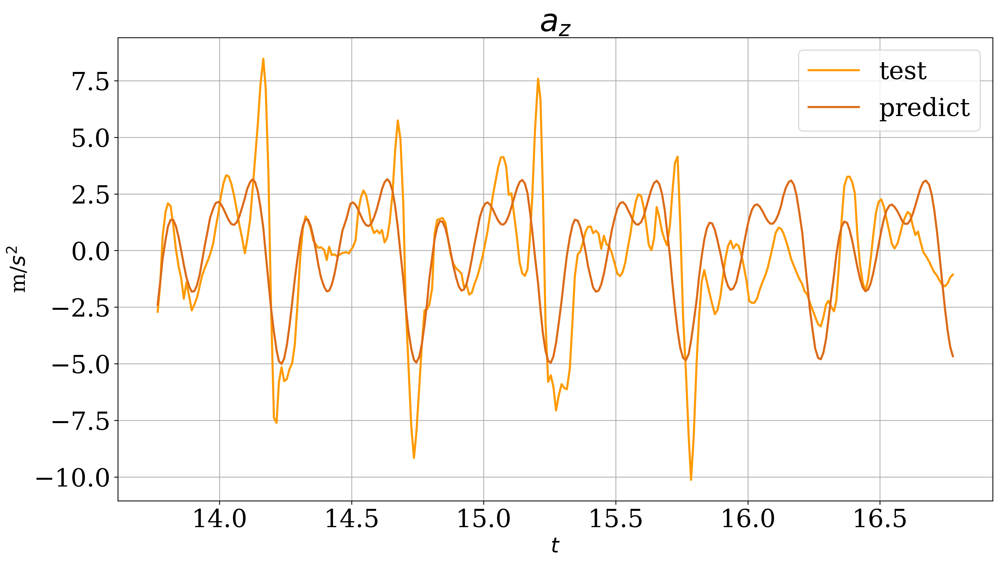

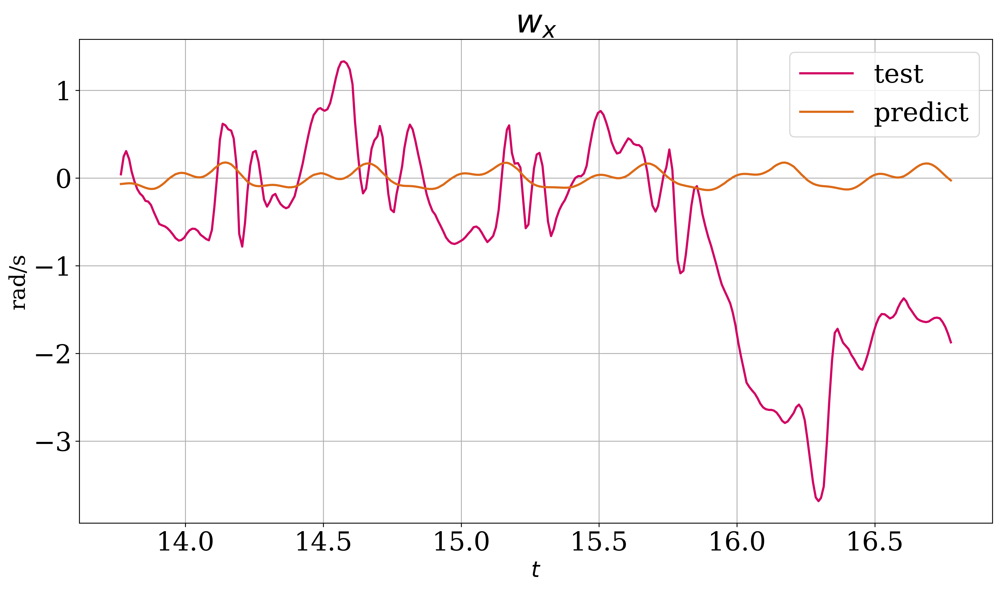

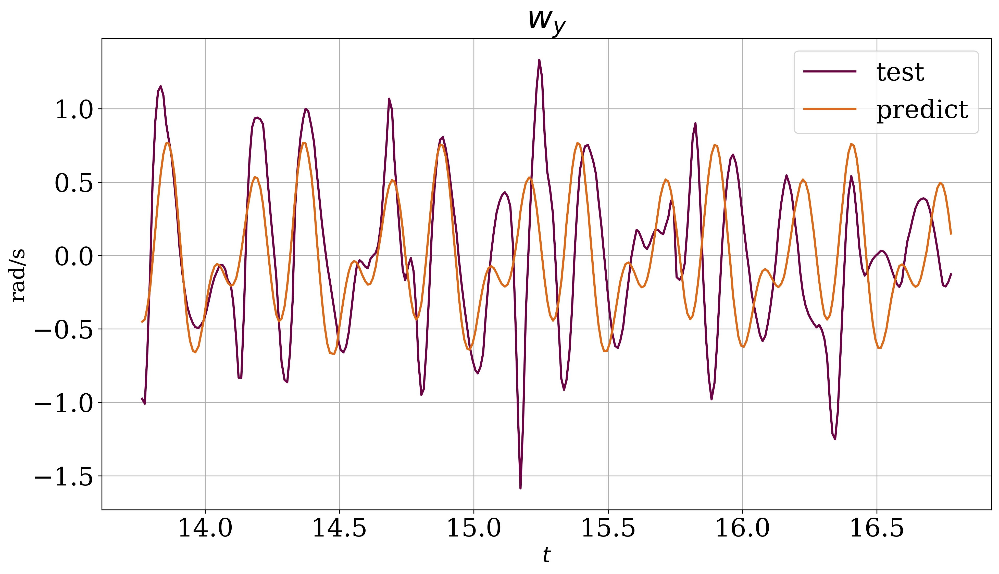

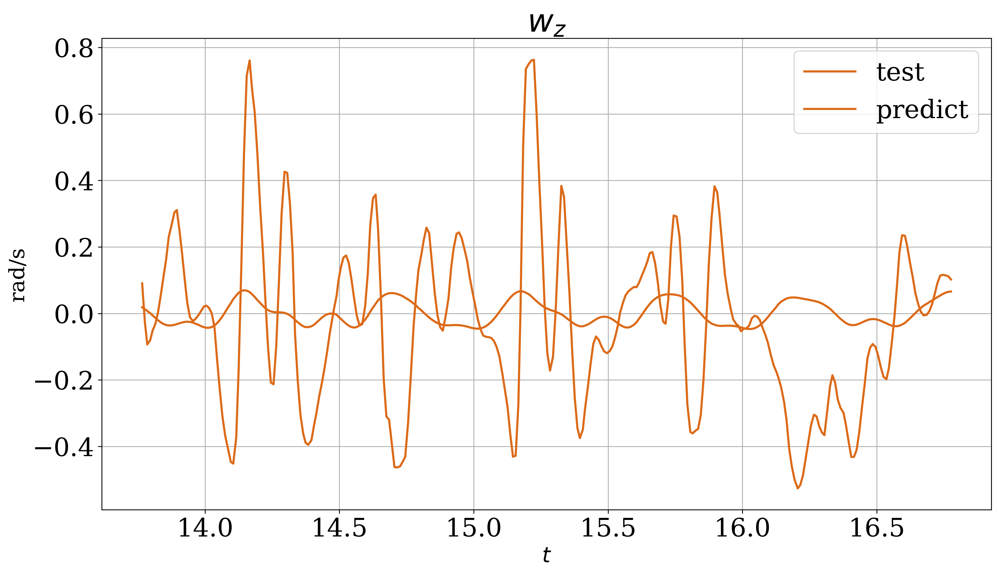

In [52]:
# plot prediction and real values
for i in range(num_signals):
    with EnableJournalStylePlotting():
        fig, ax = plt.subplots(figsize=(15, 8))

        ax.plot(time_grid_test, test_data.T[i], color=color_list[i], label='test')
        ax.plot(time_grid_test, forecast_mssa.T[i], color=color_list[-1], label='predict')

        ax.grid(True)
        ax.legend();
        ax.set_ylabel(f'{sig_units[i]}', fontsize=20)
        ax.set_xlabel('$t$', fontsize=20)
        ax.set_title(f'{sig_names[i]}', fontsize=30)

        fig.savefig(f'./figs/prediction/{sig_names[i].replace(" ", "_")}.eps',
                             format='eps')

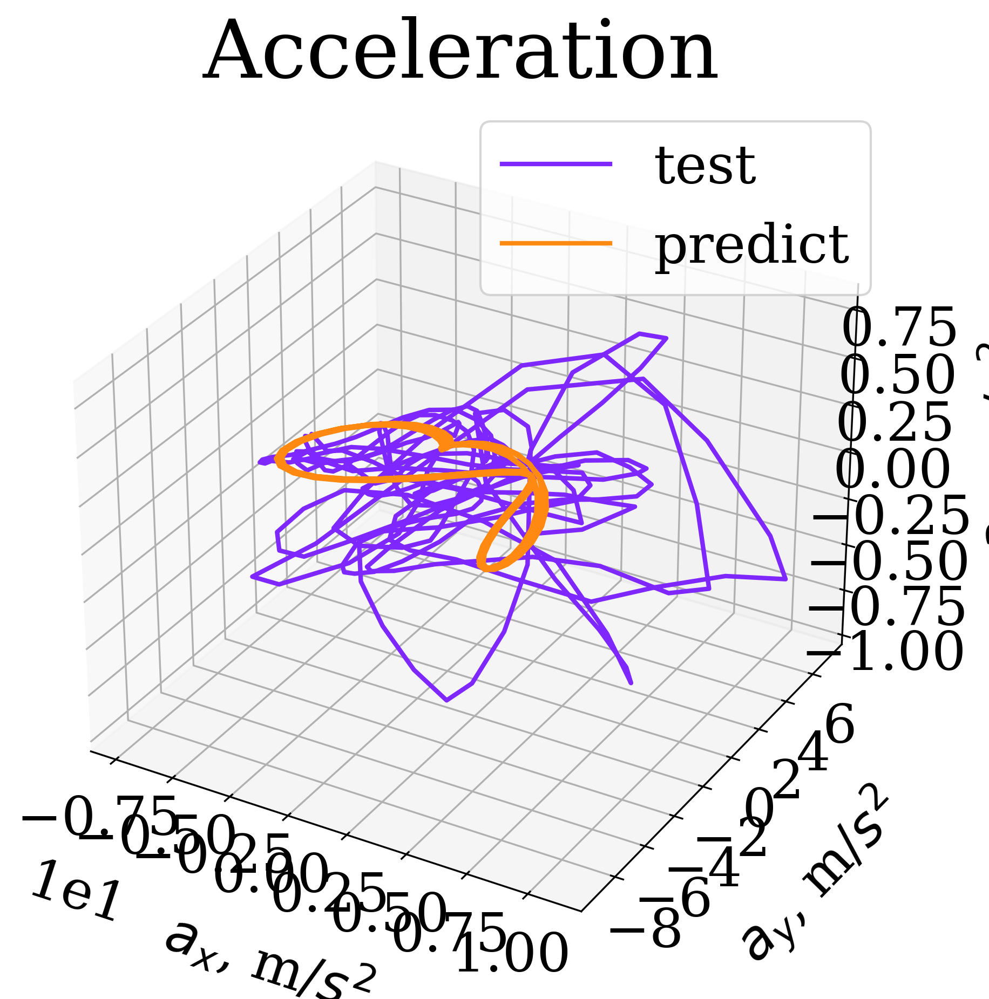

In [53]:
component_colors = ["#7F27FF", "#FF8911"]

with EnableJournalStylePlotting():
    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(projection='3d')

    ax.plot(*(test_data.T[:3]), color=component_colors[0], label="test")
    ax.plot(*(forecast_mssa.T[:3]), color=component_colors[1], label="predict")

    ax.set_xlabel(f"{sig_names[0]}, {sig_units[0]}", labelpad=21)
    ax.set_ylabel(f"{sig_names[1]}, {sig_units[1]}", labelpad=21)
    ax.set_zlabel(f"{sig_names[2]}, {sig_units[2]}", labelpad=21)
    ax.set_title(f"Acceleration")
    ax.legend()

    for axis in ["x", "y", "z"]:
        ax.ticklabel_format(axis=axis, style="scientific", scilimits=(0, 0))
    
    fig.savefig(f"./figs/prediction/acceler.png", format='png')

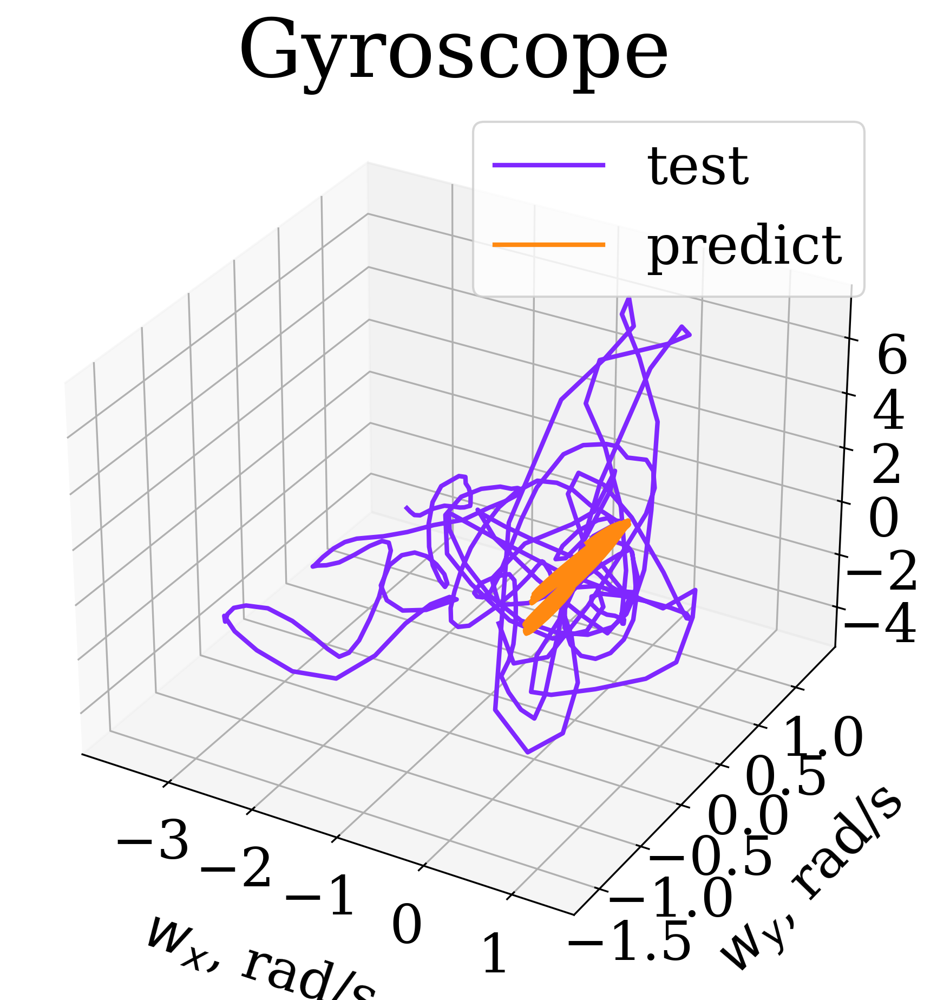

In [54]:
with EnableJournalStylePlotting():
    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(projection='3d')

    ax.plot(*(test_data.T[3:]), color=component_colors[0], label="test")
    ax.plot(*(forecast_mssa.T[3:]), color=component_colors[1], label="predict")

    ax.set_xlabel(f"{sig_names[3]}, {sig_units[3]}", labelpad=21)
    ax.set_ylabel(f"{sig_names[4]}, {sig_units[4]}", labelpad=21)
    ax.set_zlabel(f"{sig_names[5]}, {sig_units[5]}", labelpad=21)
    ax.set_title(f"Gyroscope")
    ax.legend()

    for axis in ["x", "y", "z"]:
        ax.ticklabel_format(axis=axis, style="scientific", scilimits=(0, 0))
    
    fig.savefig(f"./figs/prediction/gyro.png", format='png')